In [2]:
# Load dependencies
import os
import re
import pycallingcards as cc
import scanpy as sc
import pandas as pd
import scipy as sp
import numpy as np
from scipy import stats
from scipy.stats import norm
from statsmodels.stats.multitest import fdrcorrection
import seaborn as sns
import matplotlib.pyplot as plt
import pickle as pkl
import pybedtools
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
from pydeseq2.utils import load_example_data
from __future__ import print_function
import random
from typing import List, Tuple, Dict, Optional, Literal, Set
from itertools import combinations
from appdirs import user_cache_dir
from urllib import request
import tempfile
import pybedtools
#sets the figure DPI for the matplotlib plots
plt.rcParams['figure.dpi'] = 150

In [3]:
# Read data as pandas dataframe
total_data = pd.read_csv("total_data.txt",sep = '\t',header= None)
total_data.columns = ['Chr','Start','End','Reads','Direction','Barcodes','SampleID','Score','group']
total_data

,Chr,Start,End,Reads,Direction,Barcodes,SampleID,Score,group
0,chr1,3025529,3025530,21,+,GAAG,16_7,2,mild
1,chr1,3036943,3036944,397,+,TCAG,2_2,8,severe
2,chr1,3048299,3048300,6,-,GTGT,16_7,2,mild
3,chr1,3060728,3060729,75,-,GAAG,14_5,3,mild
4,chr1,3060728,3060729,2,-,GTGT,6_5,8,severe
...,...,...,...,...,...,...,...,...,...
8238101,chrY,90811001,90811002,311,+,TTGG,2_2,8,severe
8238102,chrY,90811001,90811002,326,+,TCGA,2_2,8,severe
8238103,chrY,90811001,90811002,146,+,TGAC,9_5,8,severe
8238104,chrY,90811001,90811002,326,+,GAGA,11_1,8,severe


In [ ]:
# I ran the first 20 shuffled arrangements separately, so this notebook shows how to run the next 30, for a total of 50.

In [3]:
# Create shuffled IDs that are balanced for seizure group and insertion counts, without repeating first twenty

def calculate_total(group: List[Tuple[str, int]]) -> int:
    return sum(count for _, count in group)

def format_group_csv(group: List[Tuple[str, int]]) -> str:
    return ', '.join(f'"{id_}"' for id_, _ in sorted(group))

def get_canonical_signature(group_a: List[Tuple[str, int]], 
                          group_b: List[Tuple[str, int]]) -> str:
    sig_a = ','.join(sorted(id_ for id_, _ in group_a))
    sig_b = ','.join(sorted(id_ for id_, _ in group_b))
    return sig_a + '|' + sig_b if sig_a < sig_b else sig_b + '|' + sig_a

def is_unique_arrangement(group_a: List[Tuple[str, int]], 
                         group_b: List[Tuple[str, int]], 
                         seen_arrangements: Set[str]) -> bool:
    sig = get_canonical_signature(group_a, group_b)
    if sig in seen_arrangements:
        return False
    seen_arrangements.add(sig)
    return True

In [4]:
# Create shuffled IDs that are balanced for seizure group and insertion counts, without repeating first twenty
def generate_balanced_shuffle_flexible(data_a: List[Tuple[str, int]], 
                                     data_b: List[Tuple[str, int]], 
                                     seen_arrangements: Set[str],
                                     num_attempts: int = 3000,
                                     max_diff_percent: float = 12.0) -> Tuple[List[Tuple[str, int]], List[Tuple[str, int]]]:
    
    original_total = calculate_total(data_a) + calculate_total(data_b)
    
    best_diff = float('inf')
    best_groups = None
    
    # Possible splits: 4-6, 5-5, 6-4 (from data_a and data_b respectively)
    split_options = [(4, 6), (5, 5), (6, 4)]
    
    attempts = 0
    while attempts < num_attempts:
        # Randomly choose a split ratio
        split_a, split_b = random.choice(split_options)
        
        # Randomly select animals from each original group
        selected_from_a = random.sample(data_a, split_a)
        selected_from_b = random.sample(data_b, split_b)
        
        # Create the remaining animals for the second group
        remaining_from_a = [animal for animal in data_a if animal not in selected_from_a]
        remaining_from_b = [animal for animal in data_b if animal not in selected_from_b]
        
        group_1 = selected_from_a + selected_from_b
        group_2 = remaining_from_a + remaining_from_b
        
        if not is_unique_arrangement(group_1, group_2, seen_arrangements):
            attempts += 1
            continue
            
        total_1 = calculate_total(group_1)
        total_2 = calculate_total(group_2)
        
        diff = abs(total_1 - total_2)
        diff_percent = (diff / original_total) * 100
        
        if diff_percent < max_diff_percent and diff < best_diff:
            best_diff = diff
            best_groups = (group_1, group_2)
            
            if diff_percent < 5:
                break
        
        attempts += 1
    
    return best_groups

In [5]:
# Original data
group_a = [
    ("9_5", 830775), ("2_2", 625244), ("3_1", 546926), ("8_1", 451039),
    ("11_5", 398174), ("16_6", 356554), ("11_1", 235960), ("5_5", 195611),
    ("7_4", 141765), ("6_5", 134275)
]

group_b = [
    ("4_3", 1167511), ("16_7", 906495), ("14_5", 667639), ("4_2", 656353),
    ("15_7", 322171), ("1_5", 252241), ("3_2", 163168), ("9_4", 64657),
    ("5_1", 64120), ("5_2", 57428)
]

# All 20 existing arrangements to avoid duplicating
existing_arrangements = [
    # Arrangements 1-10 (original pairs)
    ([("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("15_7", 322171),
      ("3_2", 163168), ("4_2", 656353), ("4_3", 1167511), ("6_5", 134275),
      ("7_4", 141765), ("9_4", 64657)],
     [("16_6", 356554), ("16_7", 906495), ("1_5", 252241), ("2_2", 625244),
      ("3_1", 546926), ("5_1", 64120), ("5_2", 57428), ("5_5", 195611),
      ("8_1", 451039), ("9_5", 830775)]),
    
    ([("11_5", 398174), ("14_5", 667639), ("15_7", 322171), ("16_7", 906495),
      ("2_2", 625244), ("3_2", 163168), ("4_2", 656353), ("5_5", 195611),
      ("6_5", 134275), ("9_4", 64657)],
     [("11_1", 235960), ("16_6", 356554), ("1_5", 252241), ("3_1", 546926),
      ("4_3", 1167511), ("5_1", 64120), ("5_2", 57428), ("7_4", 141765),
      ("8_1", 451039), ("9_5", 830775)]),
    
    ([("14_5", 667639), ("15_7", 322171), ("16_6", 356554), ("16_7", 906495),
      ("2_2", 625244), ("3_2", 163168), ("4_2", 656353), ("5_2", 57428),
      ("5_5", 195611), ("9_4", 64657)],
     [("11_1", 235960), ("11_5", 398174), ("1_5", 252241), ("3_1", 546926),
      ("4_3", 1167511), ("5_1", 64120), ("6_5", 134275), ("7_4", 141765),
      ("8_1", 451039), ("9_5", 830775)]),
    
    ([("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("15_7", 322171),
      ("16_6", 356554), ("16_7", 906495), ("1_5", 252241), ("2_2", 625244),
      ("5_2", 57428), ("6_5", 134275)],
     [("3_1", 546926), ("3_2", 163168), ("4_2", 656353), ("4_3", 1167511),
      ("5_1", 64120), ("5_5", 195611), ("7_4", 141765), ("8_1", 451039),
      ("9_4", 64657), ("9_5", 830775)]),
    
    ([("11_5", 398174), ("15_7", 322171), ("16_7", 906495), ("1_5", 252241),
      ("2_2", 625244), ("3_2", 163168), ("4_3", 1167511), ("5_1", 64120),
      ("5_5", 195611), ("6_5", 134275)],
     [("11_1", 235960), ("14_5", 667639), ("16_6", 356554), ("3_1", 546926),
      ("4_2", 656353), ("5_2", 57428), ("7_4", 141765), ("8_1", 451039),
      ("9_4", 64657), ("9_5", 830775)]),
    
    ([("11_1", 235960), ("16_6", 356554), ("2_2", 625244), ("3_1", 546926),
      ("3_2", 163168), ("4_3", 1167511), ("5_1", 64120), ("6_5", 134275),
      ("9_4", 64657), ("9_5", 830775)],
     [("11_5", 398174), ("14_5", 667639), ("15_7", 322171), ("16_7", 906495),
      ("1_5", 252241), ("4_2", 656353), ("5_2", 57428), ("5_5", 195611),
      ("7_4", 141765), ("8_1", 451039)]),
    
    ([("16_6", 356554), ("16_7", 906495), ("1_5", 252241), ("3_1", 546926),
      ("4_2", 656353), ("5_2", 57428), ("6_5", 134275), ("8_1", 451039),
      ("9_4", 64657), ("9_5", 830775)],
     [("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("15_7", 322171),
      ("2_2", 625244), ("3_2", 163168), ("4_3", 1167511), ("5_1", 64120),
      ("5_5", 195611), ("7_4", 141765)]),
    
    ([("14_5", 667639), ("15_7", 322171), ("16_7", 906495), ("3_2", 163168),
      ("4_2", 656353), ("5_1", 64120), ("5_2", 57428), ("5_5", 195611),
      ("7_4", 141765), ("9_5", 830775)],
     [("11_1", 235960), ("11_5", 398174), ("16_6", 356554), ("1_5", 252241),
      ("2_2", 625244), ("3_1", 546926), ("4_3", 1167511), ("6_5", 134275),
      ("8_1", 451039), ("9_4", 64657)]),
    
    ([("11_5", 398174), ("15_7", 322171), ("1_5", 252241), ("3_1", 546926),
      ("4_3", 1167511), ("5_2", 57428), ("5_5", 195611), ("8_1", 451039),
      ("9_4", 64657), ("9_5", 830775)],
     [("11_1", 235960), ("14_5", 667639), ("16_6", 356554), ("16_7", 906495),
      ("2_2", 625244), ("3_2", 163168), ("4_2", 656353), ("5_1", 64120),
      ("6_5", 134275), ("7_4", 141765)]),
    
    ([("11_5", 398174), ("14_5", 667639), ("15_7", 322171), ("16_6", 356554),
      ("1_5", 252241), ("3_1", 546926), ("4_3", 1167511), ("5_1", 64120),
      ("5_2", 57428), ("5_5", 195611)],
     [("11_1", 235960), ("16_7", 906495), ("2_2", 625244), ("3_2", 163168),
      ("4_2", 656353), ("6_5", 134275), ("7_4", 141765), ("8_1", 451039),
      ("9_4", 64657), ("9_5", 830775)]),
    
    # Arrangements 11-20
    ([("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("2_2", 625244), 
      ("3_1", 546926), ("3_2", 163168), ("5_1", 64120), ("5_5", 195611), 
      ("8_1", 451039), ("9_5", 830775)],
     [("15_7", 322171), ("16_6", 356554), ("16_7", 906495), ("1_5", 252241), 
      ("4_2", 656353), ("4_3", 1167511), ("5_2", 57428), ("6_5", 134275), 
      ("7_4", 141765), ("9_4", 64657)]),
    
    ([("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("16_6", 356554), 
      ("16_7", 906495), ("2_2", 625244), ("3_2", 163168), ("4_2", 656353), 
      ("5_2", 57428), ("9_4", 64657)],
     [("15_7", 322171), ("1_5", 252241), ("3_1", 546926), ("4_3", 1167511), 
      ("5_1", 64120), ("5_5", 195611), ("6_5", 134275), ("7_4", 141765), 
      ("8_1", 451039), ("9_5", 830775)]),
    
    ([("14_5", 667639), ("16_7", 906495), ("1_5", 252241), ("2_2", 625244), 
      ("3_1", 546926), ("3_2", 163168), ("4_2", 656353), ("5_1", 64120), 
      ("7_4", 141765), ("9_4", 64657)],
     [("11_1", 235960), ("11_5", 398174), ("15_7", 322171), ("16_6", 356554), 
      ("4_3", 1167511), ("5_2", 57428), ("5_5", 195611), ("6_5", 134275), 
      ("8_1", 451039), ("9_5", 830775)]),
    
    ([("11_5", 398174), ("15_7", 322171), ("16_6", 356554), ("16_7", 906495), 
      ("2_2", 625244), ("5_1", 64120), ("5_2", 57428), ("8_1", 451039), 
      ("9_4", 64657), ("9_5", 830775)],
     [("11_1", 235960), ("14_5", 667639), ("1_5", 252241), ("3_1", 546926), 
      ("3_2", 163168), ("4_2", 656353), ("4_3", 1167511), ("5_5", 195611), 
      ("6_5", 134275), ("7_4", 141765)]),
    
    ([("15_7", 322171), ("16_6", 356554), ("3_1", 546926), ("3_2", 163168), 
      ("4_3", 1167511), ("5_1", 64120), ("6_5", 134275), ("7_4", 141765), 
      ("8_1", 451039), ("9_5", 830775)],
     [("11_1", 235960), ("11_5", 398174), ("14_5", 667639), ("16_7", 906495), 
      ("1_5", 252241), ("2_2", 625244), ("4_2", 656353), ("5_2", 57428), 
      ("5_5", 195611), ("9_4", 64657)]),
    
    ([("11_5", 398174), ("14_5", 667639), ("16_6", 356554), ("16_7", 906495), 
      ("4_3", 1167511), ("5_1", 64120), ("5_2", 57428), ("5_5", 195611), 
      ("6_5", 134275), ("7_4", 141765)],
     [("11_1", 235960), ("15_7", 322171), ("1_5", 252241), ("2_2", 625244), 
      ("3_1", 546926), ("3_2", 163168), ("4_2", 656353), ("8_1", 451039), 
      ("9_4", 64657), ("9_5", 830775)]),
    
    ([("14_5", 667639), ("15_7", 322171), ("3_2", 163168), ("4_2", 656353), 
      ("4_3", 1167511), ("5_2", 57428), ("5_5", 195611), ("6_5", 134275), 
      ("7_4", 141765), ("8_1", 451039)],
     [("11_1", 235960), ("11_5", 398174), ("16_6", 356554), ("16_7", 906495), 
      ("1_5", 252241), ("2_2", 625244), ("3_1", 546926), ("5_1", 64120), 
      ("9_4", 64657), ("9_5", 830775)]),
    
    ([("11_1", 235960), ("14_5", 667639), ("1_5", 252241), ("2_2", 625244), 
      ("4_2", 656353), ("5_2", 57428), ("5_5", 195611), ("6_5", 134275), 
      ("8_1", 451039), ("9_5", 830775)],
     [("11_5", 398174), ("15_7", 322171), ("16_6", 356554), ("16_7", 906495), 
      ("3_1", 546926), ("3_2", 163168), ("4_3", 1167511), ("5_1", 64120), 
      ("7_4", 141765), ("9_4", 64657)]),
    
    ([("11_5", 398174), ("16_6", 356554), ("16_7", 906495), ("2_2", 625244), 
      ("3_2", 163168), ("4_2", 656353), ("5_1", 64120), ("5_2", 57428), 
      ("6_5", 134275), ("9_5", 830775)],
     [("11_1", 235960), ("14_5", 667639), ("15_7", 322171), ("1_5", 252241), 
      ("3_1", 546926), ("4_3", 1167511), ("5_5", 195611), ("7_4", 141765), 
      ("8_1", 451039), ("9_4", 64657)]),
    
    ([("11_5", 398174), ("14_5", 667639), ("15_7", 322171), ("16_6", 356554), 
      ("1_5", 252241), ("3_2", 163168), ("4_3", 1167511), ("5_2", 57428), 
      ("5_5", 195611), ("8_1", 451039)],
     [("11_1", 235960), ("16_7", 906495), ("2_2", 625244), ("3_1", 546926), 
      ("4_2", 656353), ("5_1", 64120), ("6_5", 134275), ("7_4", 141765), 
      ("9_4", 64657), ("9_5", 830775)])
]

In [6]:
# Initialize seen_arrangements with all existing arrangements
seen_arrangements = set()
for group_a_arr, group_b_arr in existing_arrangements:
    is_unique_arrangement(group_a_arr, group_b_arr, seen_arrangements)

# Generate new unique arrangements starting from arrangement 21
def generate_new_arrangements(num_new_arrangements: int = 10):
    solutions = []
    for i in range(num_new_arrangements):
        result = generate_balanced_shuffle_flexible(group_a, group_b, seen_arrangements)
        if result is None:
            print(f"Could not find unique arrangement for slot {i + 21}")
            continue
            
        new_a, new_b = result
        total_a = calculate_total(new_a)
        total_b = calculate_total(new_b)
        diff = abs(total_a - total_b)
        diff_percent = (diff / (total_a + total_b)) * 100
        
        # Count animals from each original group
        a_from_original_a = sum(1 for animal in new_a if animal in group_a)
        a_from_original_b = sum(1 for animal in new_a if animal in group_b)
        
        solutions.append({
            'arrangement': i + 21,
            'group_a': new_a,
            'group_b': new_b,
            'total_a': total_a,
            'total_b': total_b,
            'diff': diff,
            'diff_percent': diff_percent,
            'a_from_orig_a': a_from_original_a,
            'a_from_orig_b': a_from_original_b
        })
    
    return solutions

In [ ]:
# Below is where I generate the last 30 arrangements. You can use it to get 50 all together.

In [7]:
# Generate 30 new arrangements (21-50)
new_solutions = generate_new_arrangements(30)

# Print results
for sol in new_solutions:
    print(f"\nArrangement {sol['arrangement']}")
    print(f"Group A (Total: {sol['total_a']:,}) - {sol['a_from_orig_a']} from orig A, {sol['a_from_orig_b']} from orig B")
    print(format_group_csv(sol['group_a']))
    print(f"\nGroup B (Total: {sol['total_b']:,}) - {10-sol['a_from_orig_a']} from orig A, {10-sol['a_from_orig_b']} from orig B")
    print(format_group_csv(sol['group_b']))
    print(f"Difference: {sol['diff']:,} ({sol['diff_percent']:.1f}%)")
    print("-" * 50)

print(f"\nGenerated {len(new_solutions)} new unique arrangements.")
print(f"Total arrangements tracked: {len(seen_arrangements)}")


Arrangement 21
Group A (Total: 4,223,176) - 4 from orig A, 6 from orig B
"11_1", "14_5", "16_6", "16_7", "1_5", "4_2", "5_1", "5_2", "5_5", "9_5"

Group B (Total: 4,014,930) - 6 from orig A, 4 from orig B
"11_5", "15_7", "2_2", "3_1", "3_2", "4_3", "6_5", "7_4", "8_1", "9_4"
Difference: 208,246 (2.5%)
--------------------------------------------------

Arrangement 22
Group A (Total: 4,042,297) - 4 from orig A, 6 from orig B
"14_5", "15_7", "16_7", "1_5", "2_2", "3_1", "5_1", "7_4", "8_1", "9_4"

Group B (Total: 4,195,809) - 6 from orig A, 4 from orig B
"11_1", "11_5", "16_6", "3_2", "4_2", "4_3", "5_2", "5_5", "6_5", "9_5"
Difference: 153,512 (1.9%)
--------------------------------------------------

Arrangement 23
Group A (Total: 4,148,170) - 4 from orig A, 6 from orig B
"11_5", "14_5", "16_6", "16_7", "1_5", "3_2", "5_2", "8_1", "9_4", "9_5"

Group B (Total: 4,089,936) - 6 from orig A, 4 from orig B
"11_1", "15_7", "2_2", "3_1", "4_2", "4_3", "5_1", "5_5", "6_5", "7_4"
Difference: 5

In [6]:
# Print output to text below - the %%capture needs to be first line

In [10]:
%%capture cap

for sol in new_solutions:
    print(f"\nArrangement {sol['arrangement']}")
    print(f"Group A (Total: {sol['total_a']:,}) - {sol['a_from_orig_a']} from orig A, {sol['a_from_orig_b']} from orig B")
    print(format_group_csv(sol['group_a']))
    print(f"\nGroup B (Total: {sol['total_b']:,}) - {10-sol['a_from_orig_a']} from orig A, {10-sol['a_from_orig_b']} from orig B")
    print(format_group_csv(sol['group_b']))
    print(f"Difference: {sol['diff']:,} ({sol['diff_percent']:.1f}%)")
    print("-" * 50)

print(f"\nGenerated {len(new_solutions)} new unique arrangements.")
print(f"Total arrangements tracked: {len(seen_arrangements)}")

with open('shuffled_IDs_21_50.txt','w') as file:
    file.write(cap.stdout)

In [4]:
# Create dictionary for shuffled animal IDs
id_dict = {21: ["11_1", "14_5", "16_6", "16_7", "1_5", "4_2", "5_1", "5_2", "5_5", "9_5", "11_5", "15_7", "2_2", "3_1", "3_2", "4_3", "6_5", "7_4", "8_1", "9_4"], 22: ["14_5", "15_7", "16_7", "1_5", "2_2", "3_1", "5_1", "7_4", "8_1", "9_4", "11_1", "11_5", "16_6", "3_2", "4_2", "4_3", "5_2", "5_5", "6_5", "9_5"], 23: ["11_5", "14_5", "16_6", "16_7", "1_5", "3_2", "5_2", "8_1", "9_4", "9_5", "11_1", "15_7", "2_2", "3_1", "4_2", "4_3", "5_1", "5_5", "6_5", "7_4"], 24: ["2_2", "3_2", "4_2", "4_3", "5_1", "5_2", "5_5", "8_1", "9_4", "9_5", "11_1", "11_5", "14_5", "15_7", "16_6", "16_7", "1_5", "3_1", "6_5", "7_4"], 25: ["11_1", "14_5", "16_6", "16_7", "3_2", "4_2", "5_2", "6_5", "9_4", "9_5", "11_5", "15_7", "1_5", "2_2", "3_1", "4_3", "5_1", "5_5", "7_4", "8_1"], 26: ["11_1", "15_7", "2_2", "3_1", "4_2", "5_1", "5_2", "7_4", "8_1", "9_5", "11_5", "14_5", "16_6", "16_7", "1_5", "3_2", "4_3", "5_5", "6_5", "9_4"], 27: ["11_1", "11_5", "15_7", "16_7", "3_1", "3_2", "4_2", "5_2", "5_5", "8_1", "14_5", "16_6", "1_5", "2_2", "4_3", "5_1", "6_5", "7_4", "9_4", "9_5"], 28: ["15_7", "16_7", "1_5", "2_2", "3_1", "4_3", "5_1", "5_5", "6_5", "9_4", "11_1", "11_5", "14_5", "16_6", "3_2", "4_2", "5_2", "7_4", "8_1", "9_5"], 29: ["14_5", "16_6", "16_7", "3_1", "4_3", "5_1", "5_2", "5_5", "6_5", "9_4", "11_1", "11_5", "15_7", "1_5", "2_2", "3_2", "4_2", "7_4", "8_1", "9_5"], 30: ["11_1", "14_5", "2_2", "3_1", "3_2", "4_3", "5_2", "5_5", "6_5", "8_1", "11_5", "15_7", "16_6", "16_7", "1_5", "4_2", "5_1", "7_4", "9_4", "9_5"], 31: ["16_7", "1_5", "2_2", "3_2", "4_2", "5_1", "5_5", "7_4", "8_1", "9_5", "11_1", "11_5", "14_5", "15_7", "16_6", "3_1", "4_3", "5_2", "6_5", "9_4"], 32: ["11_1", "14_5", "15_7", "16_7", "1_5", "2_2", "5_1", "5_2", "6_5", "9_5", "11_5", "16_6", "3_1", "3_2", "4_2", "4_3", "5_5", "7_4", "8_1", "9_4"], 33: ["11_5", "15_7", "2_2", "3_1", "4_2", "4_3", "5_1", "5_2", "7_4", "9_4", "11_1", "14_5", "16_6", "16_7", "1_5", "3_2", "5_5", "6_5", "8_1", "9_5"], 34: ["14_5", "16_6", "16_7", "4_2", "5_1", "5_2", "5_5", "7_4", "9_4", "9_5", "11_1", "11_5", "15_7", "1_5", "2_2", "3_1", "3_2", "4_3", "6_5", "8_1"], 35: ["11_5", "14_5", "15_7", "16_6", "16_7", "1_5", "3_1", "4_2", "5_1", "6_5", "11_1", "2_2", "3_2", "4_3", "5_2", "5_5", "7_4", "8_1", "9_4", "9_5"], 36: ["11_5", "15_7", "16_6", "16_7", "1_5", "2_2", "3_2", "4_2", "5_2", "5_5", "11_1", "14_5", "3_1", "4_3", "5_1", "6_5", "7_4", "8_1", "9_4", "9_5"], 37: ["11_1", "11_5", "14_5", "16_7", "2_2", "3_2", "4_2", "5_1", "6_5", "9_4", "15_7", "16_6", "1_5", "3_1", "4_3", "5_2", "5_5", "7_4", "8_1", "9_5"], 38: ["16_6", "1_5", "4_2", "4_3", "5_1", "5_2", "5_5", "7_4", "8_1", "9_5", "11_1", "11_5", "14_5", "15_7", "16_7", "2_2", "3_1", "3_2", "6_5", "9_4"], 39: ["15_7", "16_6", "1_5", "2_2", "3_2", "4_2", "4_3", "5_1", "7_4", "8_1", "11_1", "11_5", "14_5", "16_7", "3_1", "5_2", "5_5", "6_5", "9_4", "9_5"], 40: ["11_5", "14_5", "15_7", "1_5", "3_2", "4_2", "6_5", "8_1", "9_4", "9_5", "11_1", "16_6", "16_7", "2_2", "3_1", "4_3", "5_1", "5_2", "5_5", "7_4"], 41: ["11_1", "15_7", "16_7", "1_5", "3_1", "5_2", "5_5", "7_4", "8_1", "9_5", "11_5", "14_5", "16_6", "2_2", "3_2", "4_2", "4_3", "5_1", "6_5", "9_4"], 42: ["11_1", "15_7", "16_7", "3_1", "3_2", "4_3", "5_1", "5_2", "7_4", "8_1", "11_5", "14_5", "16_6", "1_5", "2_2", "4_2", "5_5", "6_5", "9_4", "9_5"], 43: ["11_5", "16_6", "2_2", "3_2", "4_2", "4_3", "5_1", "5_5", "8_1", "9_4", "11_1", "14_5", "15_7", "16_7", "1_5", "3_1", "5_2", "6_5", "7_4", "9_5"], 44: ["11_1", "14_5", "16_6", "2_2", "3_1", "3_2", "4_3", "5_1", "5_5", "7_4", "11_5", "15_7", "16_7", "1_5", "4_2", "5_2", "6_5", "8_1", "9_4", "9_5"], 45: ["11_5", "16_7", "3_2", "4_3", "5_1", "5_2", "5_5", "6_5", "7_4", "9_5", "11_1", "14_5", "15_7", "16_6", "1_5", "2_2", "3_1", "4_2", "8_1", "9_4"], 46: ["11_1", "14_5", "1_5", "3_1", "3_2", "4_2", "5_5", "7_4", "8_1", "9_5", "11_5", "15_7", "16_6", "16_7", "2_2", "4_3", "5_1", "5_2", "6_5", "9_4"], 47: ["11_1", "14_5", "15_7", "16_6", "2_2", "3_2", "4_2", "5_1", "9_4", "9_5", "11_5", "16_7", "1_5", "3_1", "4_3", "5_2", "5_5", "6_5", "7_4", "8_1"], 48: ["11_5", "14_5", "1_5", "2_2", "3_2", "4_2", "5_1", "7_4", "8_1", "9_5", "11_1", "15_7", "16_6", "16_7", "3_1", "4_3", "5_2", "5_5", "6_5", "9_4"], 49: ["16_7", "1_5", "2_2", "4_3", "5_1", "5_2", "6_5", "7_4", "9_4", "9_5", "11_1", "11_5", "14_5", "15_7", "16_6", "3_1", "3_2", "4_2", "5_5", "8_1"], 50: ["11_1", "11_5", "15_7", "16_7", "3_1", "3_2", "5_2", "7_4", "8_1", "9_5", "14_5", "16_6", "1_5", "2_2", "4_2", "4_3", "5_1", "5_5", "6_5", "9_4"]}

In [5]:
# Create dictionary for shuffled animal IDs group A
id_dict_A = {21: ["11_1", "14_5", "16_6", "16_7", "1_5", "4_2", "5_1", "5_2", "5_5", "9_5"], 22: ["14_5", "15_7", "16_7", "1_5", "2_2", "3_1", "5_1", "7_4", "8_1", "9_4"], 23: ["11_5", "14_5", "16_6", "16_7", "1_5", "3_2", "5_2", "8_1", "9_4", "9_5"], 24: ["2_2", "3_2", "4_2", "4_3", "5_1", "5_2", "5_5", "8_1", "9_4", "9_5"], 25: ["11_1", "14_5", "16_6", "16_7", "3_2", "4_2", "5_2", "6_5", "9_4", "9_5"], 26: ["11_1", "15_7", "2_2", "3_1", "4_2", "5_1", "5_2", "7_4", "8_1", "9_5"], 27: ["11_1", "11_5", "15_7", "16_7", "3_1", "3_2", "4_2", "5_2", "5_5", "8_1"], 28: ["15_7", "16_7", "1_5", "2_2", "3_1", "4_3", "5_1", "5_5", "6_5", "9_4"], 29: ["14_5", "16_6", "16_7", "3_1", "4_3", "5_1", "5_2", "5_5", "6_5", "9_4"], 30: ["11_1", "14_5", "2_2", "3_1", "3_2", "4_3", "5_2", "5_5", "6_5", "8_1"], 31: ["16_7", "1_5", "2_2", "3_2", "4_2", "5_1", "5_5", "7_4", "8_1", "9_5"], 32: ["11_1", "14_5", "15_7", "16_7", "1_5", "2_2", "5_1", "5_2", "6_5", "9_5"], 33: ["11_5", "15_7", "2_2", "3_1", "4_2", "4_3", "5_1", "5_2", "7_4", "9_4"], 34: ["14_5", "16_6", "16_7", "4_2", "5_1", "5_2", "5_5", "7_4", "9_4", "9_5"], 35: ["11_5", "14_5", "15_7", "16_6", "16_7", "1_5", "3_1", "4_2", "5_1", "6_5"], 36: ["11_5", "15_7", "16_6", "16_7", "1_5", "2_2", "3_2", "4_2", "5_2", "5_5"], 37: ["11_1", "11_5", "14_5", "16_7", "2_2", "3_2", "4_2", "5_1", "6_5", "9_4"], 38: ["16_6", "1_5", "4_2", "4_3", "5_1", "5_2", "5_5", "7_4", "8_1", "9_5"], 39: ["15_7", "16_6", "1_5", "2_2", "3_2", "4_2", "4_3", "5_1", "7_4", "8_1"], 40: ["11_5", "14_5", "15_7", "1_5", "3_2", "4_2", "6_5", "8_1", "9_4", "9_5"], 41: ["11_1", "15_7", "16_7", "1_5", "3_1", "5_2", "5_5", "7_4", "8_1", "9_5"], 42: ["11_1", "15_7", "16_7", "3_1", "3_2", "4_3", "5_1", "5_2", "7_4", "8_1"], 43: ["11_5", "16_6", "2_2", "3_2", "4_2", "4_3", "5_1", "5_5", "8_1", "9_4"], 44: ["11_1", "14_5", "16_6", "2_2", "3_1", "3_2", "4_3", "5_1", "5_5", "7_4"], 45: ["11_5", "16_7", "3_2", "4_3", "5_1", "5_2", "5_5", "6_5", "7_4", "9_5"], 46: ["11_1", "14_5", "1_5", "3_1", "3_2", "4_2", "5_5", "7_4", "8_1", "9_5"], 47: ["11_1", "14_5", "15_7", "16_6", "2_2", "3_2", "4_2", "5_1", "9_4", "9_5"], 48: ["11_5", "14_5", "1_5", "2_2", "3_2", "4_2", "5_1", "7_4", "8_1", "9_5"], 49: ["16_7", "1_5", "2_2", "4_3", "5_1", "5_2", "6_5", "7_4", "9_4", "9_5"], 50: ["11_1", "11_5", "15_7", "16_7", "3_1", "3_2", "5_2", "7_4", "8_1", "9_5"]}

In [6]:
# Create dictionary for shuffled animal IDs group B
id_dict_B = {21: ["11_5", "15_7", "2_2", "3_1", "3_2", "4_3", "6_5", "7_4", "8_1", "9_4"], 22: ["11_1", "11_5", "16_6", "3_2", "4_2", "4_3", "5_2", "5_5", "6_5", "9_5"], 23: ["11_1", "15_7", "2_2", "3_1", "4_2", "4_3", "5_1", "5_5", "6_5", "7_4"], 24: ["11_1", "11_5", "14_5", "15_7", "16_6", "16_7", "1_5", "3_1", "6_5", "7_4"], 25: ["11_5", "15_7", "1_5", "2_2", "3_1", "4_3", "5_1", "5_5", "7_4", "8_1"], 26: ["11_5", "14_5", "16_6", "16_7", "1_5", "3_2", "4_3", "5_5", "6_5", "9_4"], 27: ["14_5", "16_6", "1_5", "2_2", "4_3", "5_1", "6_5", "7_4", "9_4", "9_5"], 28: ["11_1", "11_5", "14_5", "16_6", "3_2", "4_2", "5_2", "7_4", "8_1", "9_5"], 29: ["11_1", "11_5", "15_7", "1_5", "2_2", "3_2", "4_2", "7_4", "8_1", "9_5"], 30: ["11_5", "15_7", "16_6", "16_7", "1_5", "4_2", "5_1", "7_4", "9_4", "9_5"], 31: ["11_1", "11_5", "14_5", "15_7", "16_6", "3_1", "4_3", "5_2", "6_5", "9_4"], 32: ["11_5", "16_6", "3_1", "3_2", "4_2", "4_3", "5_5", "7_4", "8_1", "9_4"], 33: ["11_1", "14_5", "16_6", "16_7", "1_5", "3_2", "5_5", "6_5", "8_1", "9_5"], 34: ["11_1", "11_5", "15_7", "1_5", "2_2", "3_1", "3_2", "4_3", "6_5", "8_1"], 35: ["11_1", "2_2", "3_2", "4_3", "5_2", "5_5", "7_4", "8_1", "9_4", "9_5"], 36: ["11_1", "14_5", "3_1", "4_3", "5_1", "6_5", "7_4", "8_1", "9_4", "9_5"], 37: ["15_7", "16_6", "1_5", "3_1", "4_3", "5_2", "5_5", "7_4", "8_1", "9_5"], 38: ["11_1", "11_5", "14_5", "15_7", "16_7", "2_2", "3_1", "3_2", "6_5", "9_4"], 39: ["11_1", "11_5", "14_5", "16_7", "3_1", "5_2", "5_5", "6_5", "9_4", "9_5"], 40: ["11_1", "16_6", "16_7", "2_2", "3_1", "4_3", "5_1", "5_2", "5_5", "7_4"], 41: ["11_5", "14_5", "16_6", "2_2", "3_2", "4_2", "4_3", "5_1", "6_5", "9_4"], 42: ["11_5", "14_5", "16_6", "1_5", "2_2", "4_2", "5_5", "6_5", "9_4", "9_5"], 43: ["11_1", "14_5", "15_7", "16_7", "1_5", "3_1", "5_2", "6_5", "7_4", "9_5"], 44: ["11_5", "15_7", "16_7", "1_5", "4_2", "5_2", "6_5", "8_1", "9_4", "9_5"], 45: ["11_1", "14_5", "15_7", "16_6", "1_5", "2_2", "3_1", "4_2", "8_1", "9_4"], 46: ["11_5", "15_7", "16_6", "16_7", "2_2", "4_3", "5_1", "5_2", "6_5", "9_4"], 47: ["11_5", "16_7", "1_5", "3_1", "4_3", "5_2", "5_5", "6_5", "7_4", "8_1"], 48: ["11_1", "15_7", "16_6", "16_7", "3_1", "4_3", "5_2", "5_5", "6_5", "9_4"], 49: ["11_1", "11_5", "14_5", "15_7", "16_6", "3_1", "3_2", "4_2", "5_5", "8_1"], 50: ["14_5", "16_6", "1_5", "2_2", "4_2", "4_3", "5_1", "5_5", "6_5", "9_4"]}

In [ ]:
# I was able to run 15 at a time, so most of the code below runs the downstream analysis for arrangements #36-50.
# Depending on your machine's memory, you may be able to run more. For all 50, just substitute for n in range(0,51):

In [44]:
# Create new total data frames
for n in range(36,51):
    # First create a copy of the df for shuffling
    globals()[f'total_data_shuff{n}'] = total_data.copy()
    # For specific SampleIDs, set group A
    globals()[f'total_data_shuff{n}'].loc[globals()[f'total_data_shuff{n}']['SampleID'].isin(id_dict_A[n]), 'group'] = 'group_A'

    # For specific SampleIDs, set group B
    globals()[f'total_data_shuff{n}'].loc[globals()[f'total_data_shuff{n}']['SampleID'].isin(id_dict_B[n]), 'group'] = 'group_B'


In [46]:
# Check lengths of dataframes
for n in range(36,51):
    print(len(globals()[f'total_data_shuff{n}']))

8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106
8238106


In [8]:
# separate the rest of the shuffled dataframes and check lengths before proceeding
for n in range(21,36):
    globals()[f'total_data_shuff{n}_A'] = globals()[f'total_data_shuff{n}'][globals()[f'total_data_shuff{n}']['group'] == 'group_A']
    globals()[f'total_data_shuff{n}_A'] = globals()[f'total_data_shuff{n}_A'].reset_index(drop=True)
    print(len(globals()[f'total_data_shuff{n}_A']))

    globals()[f'total_data_shuff{n}_B'] = globals()[f'total_data_shuff{n}'][globals()[f'total_data_shuff{n}']['group'] == 'group_B']
    globals()[f'total_data_shuff{n}_B'] = globals()[f'total_data_shuff{n}_B'].reset_index(drop=True)
    print(len(globals()[f'total_data_shuff{n}_B']))

4223176
4014930
4042297
4195809
4148170
4089936
4275906
3962200
4073304
4164802
3931781
4306325
3933325
4304781
4279251
3958855
4161216
4076890
4244801
3993305
4286811
3951295
4096348
4141758
4044349
4193757
3941397
4296709
4304948
3933158


In [21]:
# call peaks on groups A and B separately
for n in range(21,51):
    globals()[f'peak_data_shuff{n}_A'] = cc.pp.call_peaks(globals()[f'total_data_shuff{n}_A'] , method = "MACCs", reference = "mm10", pvalue_adj_cutoff = 0, 
                            window_size=2000, step_size=800, lam_win_size = 1000000, pseudocounts = 1,
                             record = True, save = f'peak_shuff{n}_A.bed')
    print(len(globals()[f'peak_data_shuff{n}_A']))

    globals()[f'peak_data_shuff{n}_B'] = cc.pp.call_peaks(globals()[f'total_data_shuff{n}_B'] , method = "MACCs", reference = "mm10", pvalue_adj_cutoff = 0, 
                            window_size=2000, step_size=800, lam_win_size = 1000000, pseudocounts = 1,
                             record = True, save = f'peak_shuff{n}_B.bed')
    print(len(globals()[f'peak_data_shuff{n}_B']))

For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:41<00:00, 21.97s/it]


14527
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:28<00:00, 21.35s/it]


14351
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:59<00:00, 22.84s/it]


14438
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:49<00:00, 22.36s/it]


14328
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:51<00:00, 22.46s/it]


14538
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [08:12<00:00, 23.46s/it]


14363
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:43<00:00, 22.07s/it]


14291
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:41<00:00, 21.98s/it]


14607
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:50<00:00, 22.40s/it]


14568
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:16<00:00, 20.78s/it]


14302
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:45<00:00, 22.16s/it]


14436
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [08:34<00:00, 24.51s/it]


14480
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:13<00:00, 20.64s/it]


14049
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [08:57<00:00, 25.60s/it]


14793
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:51<00:00, 22.48s/it]


14404
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [08:45<00:00, 25.02s/it]


14403
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:45<00:00, 22.17s/it]


14642
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:18<00:00, 20.86s/it]


14249
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:27<00:00, 21.31s/it]


14103
For the MACCS method without background, [expdata, reference, pvalue_cutoff, lam_win_size, window_size, step_size, extend, pseudocounts, test_method, min_insertions, record] would be utilized.


100%|██████████| 21/21 [07:19<00:00, 20.92s/it]


14717


In [22]:
# combine group A and B peaks
for n in range(21,51):
    globals()[f'peak_data_shuff{n}'] = cc.rd.combine_qbed([globals()[f'peak_data_shuff{n}_A'], globals()[f'peak_data_shuff{n}_B']])
    globals()[f'peak_data_shuff{n}'] = pybedtools.BedTool.from_dataframe(globals()[f'peak_data_shuff{n}']).merge().to_dataframe()
    globals()[f'peak_data_shuff{n}'] = globals()[f'peak_data_shuff{n}'].rename(columns={"chrom":"Chr", "start":"Start", "end":"End"})
    print(len(globals()[f'peak_data_shuff{n}']))
    #write to bed file
    cc.rd.save_bed(globals()[f'peak_data_shuff{n}'],f'peaks_shuff{n}.bed')

16732
16701
16750
16739
16729
16719
16706
16622
16680
16602


In [47]:
# open saved peak files
for n in range(36, 51):
    globals()[f'peak_data_shuff{n}'] = pd.read_csv(f'peaks_shuff{n}.bed', sep='\t',header=None, names=['Chr','Start','End'])

In [22]:
# Annotation - 5 closest genes within 1 Mb with pre-filtering
def custom_chr_sort_key(chr_name):
    """ Key function for custom sorting of chromosome names """
    chr_name = chr_name.lower().replace('chr', '')
    if chr_name.isdigit():
        return int(chr_name)
    elif chr_name == 'x':
        return 20
    elif chr_name == 'y':
        return 21
    elif chr_name in ['m', 'mt']:
        return 22
    else:
        return 23  # Any other chromosomes will be sorted after Y

def improved_annotation(
    peaks_frame: pd.DataFrame = None,
    peaks_path: str = None,
    reference: Optional[Literal["hg38", "mm10", "sacCer3"]] = "hg38",
    save_annotation: str = None,
    bedtools_path: str = None,
    refGene: pd.DataFrame = None,
    distance_threshold: int = 1000000,  # Default 1Mb threshold
    debug: bool = False
) -> pd.DataFrame:
    """
    Annotate peak data using bedtools, finding up to 5 closest genes within a specified distance,
    excluding Rik genes, Gm genes, and other specified gene types.
    
    Parameters:
    - peaks_frame: pd.DataFrame with the first three columns as chromosome, start and end.
    - peaks_path: Path to the peak data file.
    - reference: Reference genome ("hg38", "mm10", or "sacCer3").
    - save_annotation: Path to save the annotation results.
    - bedtools_path: Path to bedtools executable.
    - refGene: Custom reference gene DataFrame.
    - distance_threshold: Maximum distance (in base pairs) to consider a gene as "close" (default: 1000000).
    - debug: If True, print debugging information.
    
    Returns:
    pd.DataFrame with peak information and up to 5 closest genes within the distance threshold 
    (excluding specified gene types).
    """
    if bedtools_path:
        pybedtools.helpers.set_bedtools_path(bedtools_path)

    # Create a temporary directory
    with tempfile.TemporaryDirectory() as tmpdir:
        # Prepare peaks data
        if peaks_path:
            peaks_df = pd.read_csv(peaks_path, sep='\t', header=None, names=['Chr', 'Start', 'End'])
        elif isinstance(peaks_frame, pd.DataFrame):
            peaks_df = peaks_frame[['Chr', 'Start', 'End']].copy()
        else:
            raise ValueError("Please provide either peaks_frame or peaks_path.")

        peaks_df['Chr'] = peaks_df['Chr'].astype(str)
        
        # Save peaks to a temporary file
        unsorted_peaks_path = os.path.join(tmpdir, "unsorted_peaks.bed")
        peaks_df.to_csv(unsorted_peaks_path, sep='\t', header=False, index=False)
        
        # Sort peaks using bedtools sort
        sorted_peaks_path = os.path.join(tmpdir, "sorted_peaks.bed")
        pybedtools.BedTool(unsorted_peaks_path).sort().saveas(sorted_peaks_path)
        peaks_bed = pybedtools.BedTool(sorted_peaks_path)

        # Prepare reference gene data
        if not isinstance(refGene, pd.DataFrame):
            PYCALLINGCARDS_CACHE_DIR = user_cache_dir("pycallingcards")
            if not os.path.exists(PYCALLINGCARDS_CACHE_DIR):
                os.makedirs(PYCALLINGCARDS_CACHE_DIR)

            filename = os.path.join(PYCALLINGCARDS_CACHE_DIR, f"refGene.{reference}.Sorted.bed")
            if not os.path.exists(filename):
                URL = f"https://github.com/The-Mitra-Lab/pycallingcards_data/releases/download/data/refGene.{reference}.Sorted.bed"
                request.urlretrieve(URL, filename)

            refGene_df = pd.read_csv(filename, sep='\t', header=None, names=["Chr", "Start", "End", "Refseq", "Gene", "Strand"])
        else:
            refGene_df = refGene.copy()

        refGene_df['Chr'] = refGene_df['Chr'].astype(str)

        # Filter genes
        def gene_filter(gene_name):
            return not (
                re.search(r'Rik$', gene_name) or  # Matches any gene ending with 'Rik'
                re.match(r'Gm\d+', gene_name) or  # Matches Gm followed by numbers
                'Rik' in gene_name  # Catches any gene with 'Rik' in the name
            )

        filtered_refGene_df = refGene_df[refGene_df['Gene'].apply(gene_filter)]

        # Save filtered refGene to a temporary file
        unsorted_refGene_path = os.path.join(tmpdir, "unsorted_filtered_refGene.bed")
        filtered_refGene_df.to_csv(unsorted_refGene_path, sep='\t', header=False, index=False)
        
        # Sort filtered refGene using bedtools sort
        sorted_refGene_path = os.path.join(tmpdir, "sorted_filtered_refGene.bed")
        pybedtools.BedTool(unsorted_refGene_path).sort().saveas(sorted_refGene_path)
        filtered_refGene_bed = pybedtools.BedTool(sorted_refGene_path)

        if debug:
            print(f"Original gene count: {len(refGene_df)}")
            print(f"Genes retained after filtering: {len(filtered_refGene_df)}")
            print(f"Genes removed by filtering: {len(refGene_df) - len(filtered_refGene_df)}")
            print("\nSample of genes retained for annotation:")
            print(filtered_refGene_df['Gene'].sample(10))
            print("\nSample of genes excluded by filtering:")
            print(refGene_df[~refGene_df['Gene'].isin(filtered_refGene_df['Gene'])]['Gene'].sample(10))

        # Perform the closest operation
        closest_result = peaks_bed.closest(filtered_refGene_bed, D="ref", t="first", k=5)

        # Convert the result to a pandas DataFrame
        result_df = closest_result.to_dataframe(
            names=["Chr", "Start", "End", "Ref_Chr", "Ref_Start", "Ref_End", "Refseq", "Gene", "Strand", "Distance"]
        )

        # Filter genes based on distance threshold and ensure chromosome match
        result_df = result_df[(result_df['Distance'].abs() <= distance_threshold) & (result_df['Chr'] == result_df['Ref_Chr'])]

        if debug:
            print("\nSample of annotated peaks:")
            print(result_df[['Chr', 'Start', 'End', 'Gene', 'Distance']].head(10))

        # Group by peak and collect gene information
        grouped = result_df.groupby(["Chr", "Start", "End"])
        
        def collect_gene_info(group):
            info = {}
            for i in range(5):
                info[f"Nearest Refseq{i+1}"] = ""
                info[f"Gene Name{i+1}"] = ""
                info[f"Direction{i+1}"] = ""
                info[f"Distance{i+1}"] = np.inf
            
            for i, (_, row) in enumerate(group.iterrows()):
                if i >= 5:
                    break
                info[f"Nearest Refseq{i+1}"] = row["Refseq"]
                info[f"Gene Name{i+1}"] = row["Gene"]
                info[f"Direction{i+1}"] = row["Strand"]
                info[f"Distance{i+1}"] = row["Distance"]
            return pd.Series(info)

        gene_info = grouped.apply(collect_gene_info).reset_index()

        # Merge with original peak data to ensure correct Chr, Start, End
        final_df = pd.merge(peaks_df, gene_info, on=['Chr', 'Start', 'End'], how='left')

        # Sort the final DataFrame back to the custom chromosome order
        final_df['Chr_sort'] = final_df['Chr'].apply(custom_chr_sort_key)
        final_df = final_df.sort_values(['Chr_sort', 'Start', 'End'])
        final_df = final_df.drop('Chr_sort', axis=1)

        # Reset the index of the final DataFrame
        final_df = final_df.reset_index(drop=True)

        if save_annotation:
            final_df.to_csv(save_annotation, index=None, sep="\t")

        if debug:
            print("\nSample of final annotated peaks:")
            print(final_df.head())
            print("\nChromosome distribution in final annotation:")
            print(final_df['Chr'].value_counts().sort_index())

    return final_df

In [49]:
# Peak annotation and save to file
for n in range(36,51):
    globals()[f'peak_anno_shuff{n}'] = improved_annotation(globals()[f'peak_data_shuff{n}'], reference="mm10", distance_threshold=1000000, debug=True)
    globals()[f'peak_anno_shuff{n}'].to_csv(f"just_peak_anno_shuff{n}.csv")

Original gene count: 36873
Genes retained after filtering: 32766
Genes removed by filtering: 4107

Sample of genes retained for annotation:
23383       Cdc42
37         Adhfe1
18687      Gabpb1
2900     Adamtsl5
17545      Cacnb4
36000       Eda2r
11104        Rbx1
29570     Mrgpra1
16366      Cuedc2
367         Stat4
Name: Gene, dtype: object

Sample of genes excluded by filtering:
3510     A730063M14Rik
67       A830018L16Rik
19003    8030411F24Rik
21414          Gm29811
28625           Gm4201
3312           Gm21304
14915          Gm37013
14103    1700122O11Rik
8432     4921517D22Rik
36804          Gm20857
Name: Gene, dtype: object

Sample of annotated peaks:
     Chr    Start      End  Gene  Distance
0   chr1  3220067  3221852  Xkr4         0
5   chr1  3245524  3247377  Xkr4         0
10  chr1  3296871  3300959  Xkr4         0
11  chr1  3296871  3300959   Rp1    989887
15  chr1  3309788  3310827  Xkr4         0
16  chr1  3309788  3310827   Rp1    980019
20  chr1  3319892  3324489  X

Original gene count: 36873
Genes retained after filtering: 32766
Genes removed by filtering: 4107

Sample of genes retained for annotation:
25705      Polr2j
7056         Ttc9
20710     Pglyrp4
10219       Ednrb
28894    Hnrnpul1
13444       Glp1r
23204       Oprd1
16254    Marveld1
3792          Lif
762         Agfg1
Name: Gene, dtype: object

Sample of genes excluded by filtering:
15505    2010003K11Rik
8723     4833422C13Rik
11549    A330009N23Rik
35257          Gm10147
6552     2410004P03Rik
11573           Gm5478
26094          Gm16367
7896     4930557F10Rik
32697    9430091E24Rik
35905    4930595M18Rik
Name: Gene, dtype: object

Sample of annotated peaks:
     Chr    Start      End  Gene  Distance
0   chr1  3219744  3221852  Xkr4         0
5   chr1  3244948  3247104  Xkr4         0
10  chr1  3296962  3300959  Xkr4         0
11  chr1  3296962  3300959   Rp1    989887
15  chr1  3308835  3310827  Xkr4         0
16  chr1  3308835  3310827   Rp1    980019
20  chr1  3319892  3324705  X

Original gene count: 36873
Genes retained after filtering: 32766
Genes removed by filtering: 4107

Sample of genes retained for annotation:
27620      Spsb2
24615      Apbb2
8408      Hnrnpk
35484       Apln
8841        Smn1
17296       Dnm1
19057    Mir1953
36625      Txlng
24730     Cep135
16076       Rln1
Name: Gene, dtype: object

Sample of genes excluded by filtering:
32909          Gm22109
3401     1700030O20Rik
21968          Gm13306
32929          Gm22291
22501          Gm12603
12549    4931420L22Rik
12533    4930453N24Rik
31388    3930402G23Rik
20841            Gm128
28724           Gm8677
Name: Gene, dtype: object

Sample of annotated peaks:
     Chr    Start      End  Gene  Distance
0   chr1  3245070  3247104  Xkr4         0
5   chr1  3296871  3300959  Xkr4         0
6   chr1  3296871  3300959   Rp1    989887
10  chr1  3309788  3310827  Xkr4         0
11  chr1  3309788  3310827   Rp1    980019
15  chr1  3319892  3324705  Xkr4         0
16  chr1  3319892  3324705   Rp1    966

Original gene count: 36873
Genes retained after filtering: 32766
Genes removed by filtering: 4107

Sample of genes retained for annotation:
13798     H2-T24
126       Tfap2b
11318      Cpne8
1251       Ube2t
24117       Cdk5
2687     Slc5a4b
29733     Snrpa1
3607     Slc39a5
13263    Fam173a
5576      Nfe2l1
Name: Gene, dtype: object

Sample of genes excluded by filtering:
17880    4930443O20Rik
24572    1700027F09Rik
36792          Gm20747
10230    4930449E01Rik
6670     F730043M19Rik
36820          Gm20738
31900    1700001D01Rik
36554    4930524N10Rik
27023           Gm5878
35234          Gm10058
Name: Gene, dtype: object

Sample of annotated peaks:
     Chr    Start      End  Gene  Distance
0   chr1  3244948  3247104  Xkr4         0
5   chr1  3296043  3300599  Xkr4         0
6   chr1  3296043  3300599   Rp1    990247
10  chr1  3309788  3310827  Xkr4         0
11  chr1  3309788  3310827   Rp1    980019
15  chr1  3319980  3324705  Xkr4         0
16  chr1  3319980  3324705   Rp1    966

Original gene count: 36873
Genes retained after filtering: 32766
Genes removed by filtering: 4107

Sample of genes retained for annotation:
26265            Lep
33150    Olfr856-ps1
6217          Ubald2
5784           Rab5c
8545          Zfp748
9275         Dennd6a
23331         Nipal3
5378           Tubd1
433             Aox1
10840           Plec
Name: Gene, dtype: object

Sample of genes excluded by filtering:
19682          Gm14308
27840           Gm8882
3283           Gm20765
8974            Gm6416
36292          Gm15023
16649    9230102O04Rik
33569    3110039I08Rik
9473           Gm10377
4826     2810408A11Rik
6518     9530020I12Rik
Name: Gene, dtype: object

Sample of annotated peaks:
     Chr    Start      End  Gene  Distance
0   chr1  3245070  3247104  Xkr4         0
5   chr1  3296871  3300959  Xkr4         0
6   chr1  3296871  3300959   Rp1    989887
10  chr1  3308835  3310827  Xkr4         0
11  chr1  3308835  3310827   Rp1    980019
15  chr1  3319892  3324705  Xkr4         0

In [50]:
# Make a group by peak Anndata object
for n in range(36,51):
    globals()[f'adata_cc_shuff{n}'] = cc.pp.make_Anndata(globals()[f'total_data_shuff{n}'], globals()[f'peak_anno_shuff{n}'], id_dict[n], key = 'SampleID')

100%|██████████| 21/21 [00:53<00:00,  2.53s/it]


In [51]:
for n in range(36,51):
    globals()[f'adata_cc_shuff{n}'].obs["group"] = np.array(["group_A", "group_A", "group_A", "group_A","group_A", "group_A", "group_A", "group_A","group_A", "group_A",
                                 "group_B", "group_B", "group_B", "group_B", "group_B", "group_B", "group_B", "group_B", "group_B", "group_B"])

In [52]:
adata_cc_shuff43.obs

,group
Index,
11_5,group_A
16_6,group_A
2_2,group_A
3_2,group_A
4_2,group_A
4_3,group_A
5_1,group_A
5_5,group_A
8_1,group_A


In [53]:
#Convert to dense array
for n in range(36,51):
    globals()[f'adata_cc_shuff{n}'].X = np.array(globals()[f'adata_cc_shuff{n}'].X.todense())

In [54]:
adata_cc_shuff42.X

array([[ 5.,  2.,  2., ...,  3.,  3., 19.],
       [ 5.,  6.,  2., ...,  3.,  5., 21.],
       [15., 15., 11., ...,  4.,  6., 35.],
       ...,
       [ 5.,  2.,  3., ...,  4.,  1.,  6.],
       [ 0.,  1.,  1., ...,  1.,  1.,  8.],
       [14.,  8.,  3., ...,  7., 11., 50.]], dtype=float32)

In [55]:
#round the array
for n in range(36,51):
    globals()[f'rounded_array_shuff{n}'] = np.round(globals()[f'adata_cc_shuff{n}'].X).T

In [56]:
# Format insertion counts table
for n in range(36,51):
    globals()[f'array_shuff{n}'] = pd.DataFrame(globals()[f'rounded_array_shuff{n}'].T)
    globals()[f'array_shuff{n}'].index = id_dict[n]
    globals()[f'array_shuff{n}'].columns = globals()[f'adata_cc_shuff{n}'].var.index

In [59]:
array_shuff41

name,chr1_3219744_3221852,chr1_3245070_3247104,chr1_3296043_3300599,chr1_3309788_3310809,chr1_3319892_3324705,chr1_3365161_3372481,chr1_3375319_3383205,chr1_3384790_3389470,chr1_3393557_3401698,chr1_3404499_3406292,chr1_3456090_3459117,chr1_3549687_3553688,chr1_3642240_3651767,chr1_3658977_3672658,chr1_4785020_4786669,chr1_4805556_4807729,chr1_4856928_4861366,chr1_5082653_5083094,chr1_5176422_5178559,chr1_5914083_5915629,chr1_6212164_6216343,chr1_6730562_6739106,chr1_7085725_7092312,chr1_7101275_7105108,chr1_7115857_7116984,chr1_7131127_7132428,chr1_7395253_7399965,chr1_8779001_8783614,chr1_8942304_8954131,chr1_9037212_9038844,chr1_9169464_9173430,chr1_9286474_9301521,chr1_9576605_9578509,chr1_9600250_9603700,chr1_9613899_9618302,chr1_9624980_9629530,chr1_9788290_9792546,chr1_9795533_9801214,chr1_9846996_9851469,chr1_9941797_9944973,chr1_9992039_9994097,chr1_10010476_10015493,chr1_10233361_10234309,chr1_10993871_10994642,chr1_11382460_11386735,chr1_11413039_11420462,chr1_11441816_11448213,chr1_11462344_11468247,chr1_12688755_12695132,chr1_13193770_13198085,chr1_14300636_14311195,chr1_15286997_15293098,chr1_15325701_15330312,chr1_15333358_15337078,chr1_15480828_15484177,chr1_15569057_15571007,chr1_15647024_15653179,chr1_15680901_15684287,chr1_15804959_15805875,chr1_15899612_15900171,chr1_16254475_16262847,chr1_16292657_16297338,chr1_16619583_16620416,chr1_16633006_16638534,chr1_16656064_16657663,chr1_16663279_16665281,chr1_16687999_16688703,chr1_16929937_16931052,chr1_17042453_17043630,chr1_17120286_17123758,chr1_17162473_17166104,chr1_18306798_18310943,chr1_18359262_18361129,chr1_18698045_18698857,chr1_18971648_18982285,chr1_19101054_19112786,chr1_20889042_20896250,chr1_20908994_20913137,chr1_20937559_20942299,chr1_21008640_21010089,chr1_21079527_21080499,chr1_21228444_21233518,chr1_21679916_21691489,chr1_21746450_21755476,chr1_21771441_21775112,chr1_21800160_21805285,chr1_21811106_21815843,chr1_21825346_21832512,chr1_21850036_21852400,chr1_21855998_21858660,chr1_21939387_21942065,chr1_21957923_21964176,chr1_22260019_22263853,chr1_22264542_22269446,chr1_22532804_22534988,chr1_22613693_22618227,chr1_22624540_22628976,chr1_22652710_22659867,chr1_22660915_22665570,chr1_22692547_22698874,chr1_22716887_22721502,chr1_22723837_22728025,chr1_22767436_22771688,chr1_22797160_22809250,chr1_22883458_22884637,chr1_23117082_23120306,chr1_23255168_23259205,chr1_23764021_23767691,chr1_23832395_23838934,chr1_23926823_23928696,chr1_23932052_23935569,chr1_24365467_24369517,chr1_24382609_24383612,chr1_24557043_24561916,chr1_24563250_24566048,chr1_24583943_24590904,chr1_24619961_24622107,chr1_24671089_24678263,chr1_25080892_25086696,chr1_25126929_25128915,chr1_25159303_25163619,chr1_25173107_25179701,chr1_25187146_25194269,chr1_25199575_25202888,chr1_25226393_25233506,chr1_25376534_25378224,chr1_25575079_25579879,chr1_25607229_25613984,chr1_25615164_25617416,chr1_25618985_25633498,chr1_25642261_25649477,chr1_25694634_25701475,chr1_25789480_25798970,chr1_25801327_25813171,chr1_25822373_25836190,chr1_26280893_26284282,chr1_27297041_27300514,chr1_27628526_27629827,chr1_28347511_28349495,chr1_28969390_28976290,chr1_29181604_29183409,chr1_30135526_30139049,chr1_30416280_30418330,chr1_30495953_30498190,chr1_30582999_30585220,chr1_30590361_30591616,chr1_30948246_30951290,chr1_32171726_32176730,chr1_32211199_32215907,chr1_32221594_32225562,chr1_32230057_32231366,chr1_32239411_32248652,chr1_32292676_32295735,chr1_32337820_32339927,chr1_32344571_32349541,chr1_32442648_32446934,chr1_32461750_32463873,chr1_32551216_32555692,chr1_32631121_32635934,chr1_33270128_33272012,chr1_33669340_33673769,chr1_33690614_33691663,chr1_33739589_33743831,chr1_33750402_33759662,chr1_33904628_33907092,chr1_33945598_33947918,chr1_33960196_33960828,chr1_34004074_34008418,chr1_34039278_34041454,chr1_34408827_34410323,chr1_34433387_34435909,chr1_34578043_34579426,chr1_34778613_34780639,chr1_34813061_34814057,chr1_34843098_34843699,chr1_34847055_34853488,chr1_35201048_35204178,chr1_3

In [60]:
# Write insertion counts to file
for n in range(36,51):
    globals()[f'array_shuff{n}'].to_csv(f'insertion_counts_shuff{n}.csv')

In [61]:
#fisher exact
for n in range(36,51):
    cc.tl.rank_peak_groups(globals()[f'adata_cc_shuff{n}'],"group",method = 'fisher_exact',key_added = 'fisher_exact',by ="sample")

100%|██████████| 2/2 [02:02<00:00, 61.48s/it]


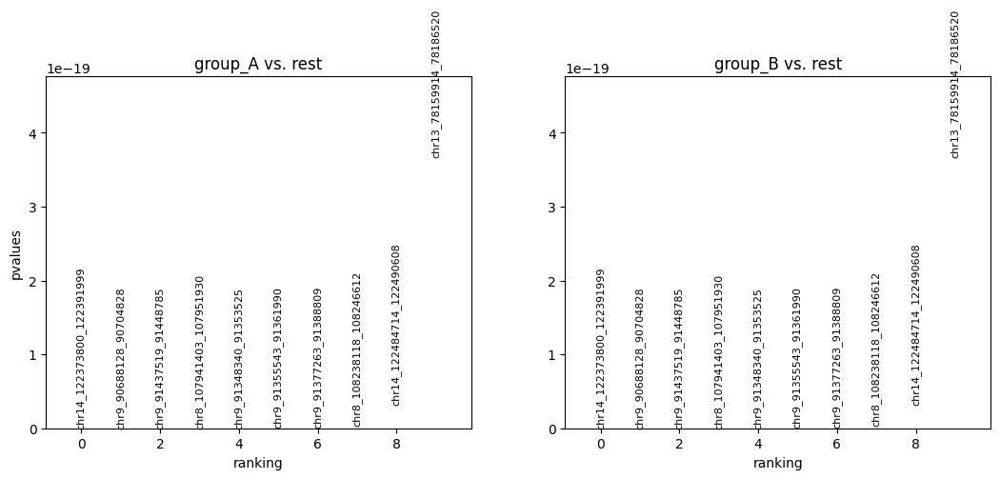

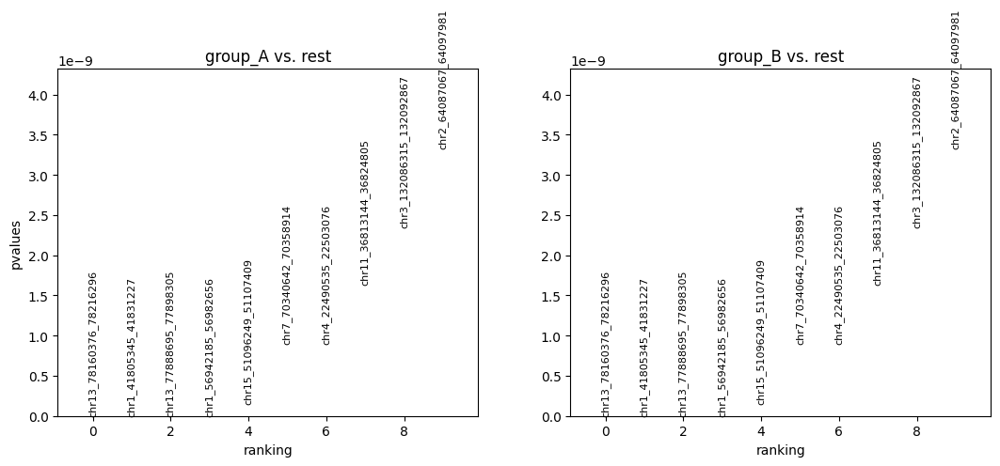

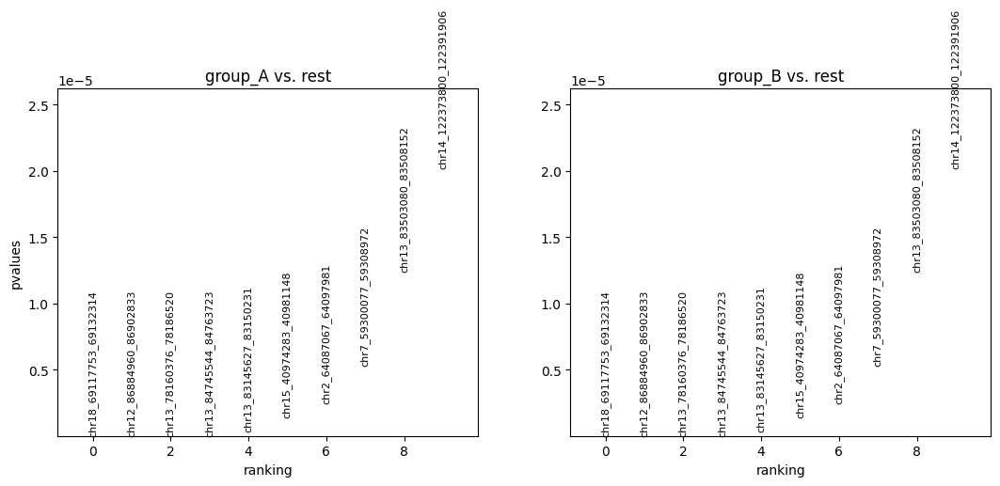

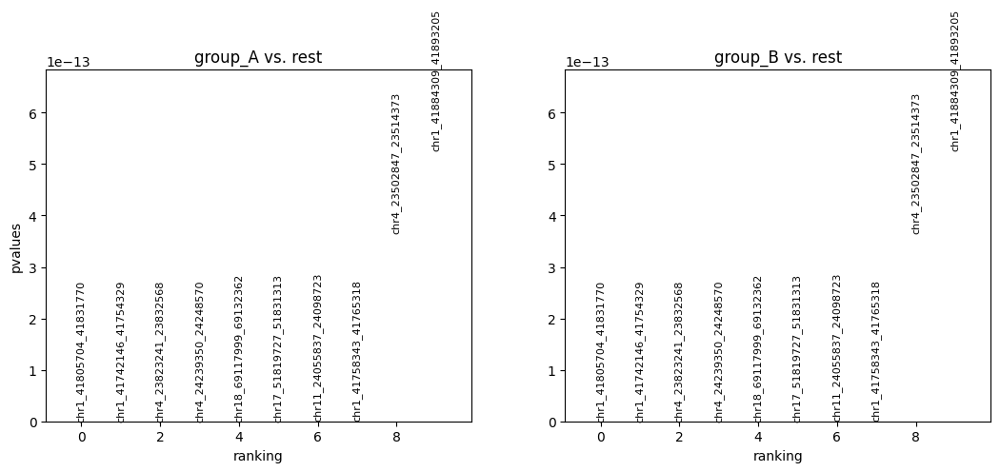

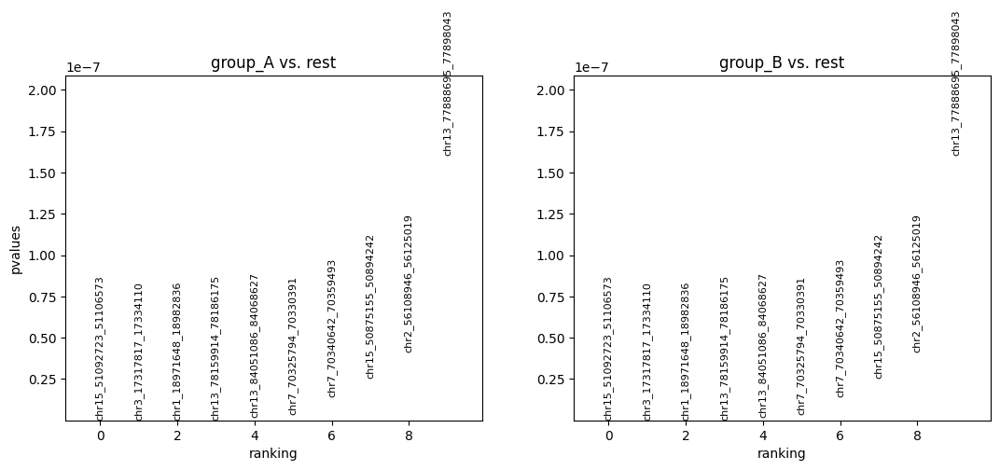

...

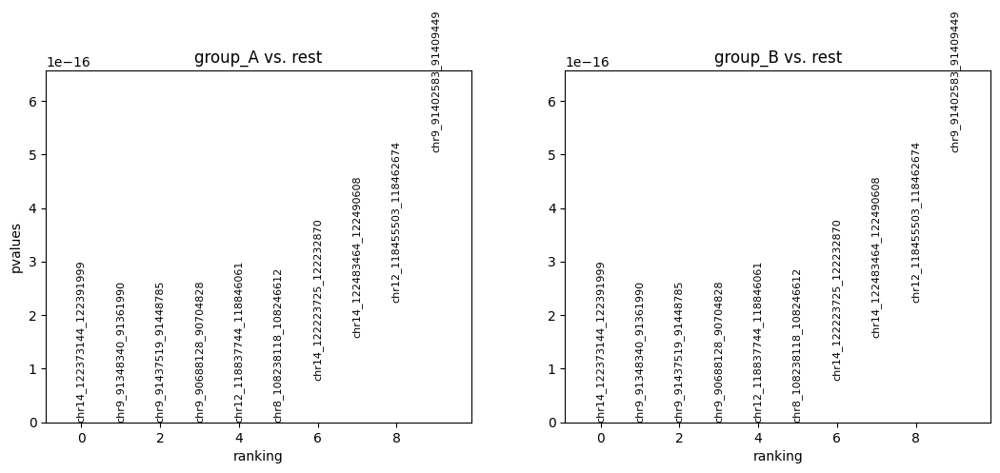

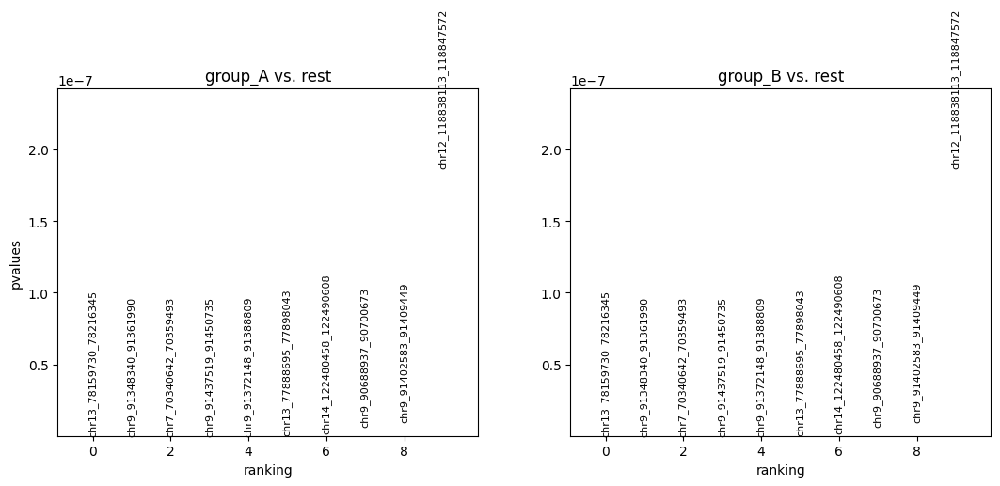

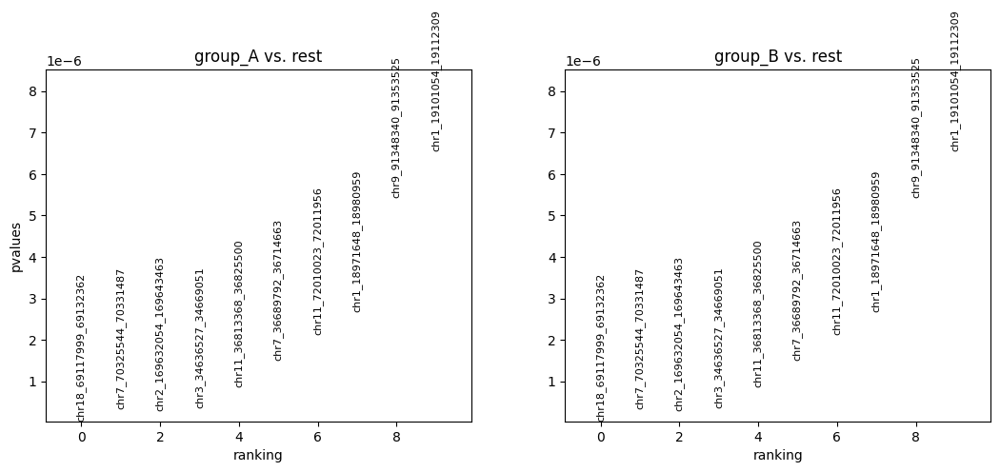

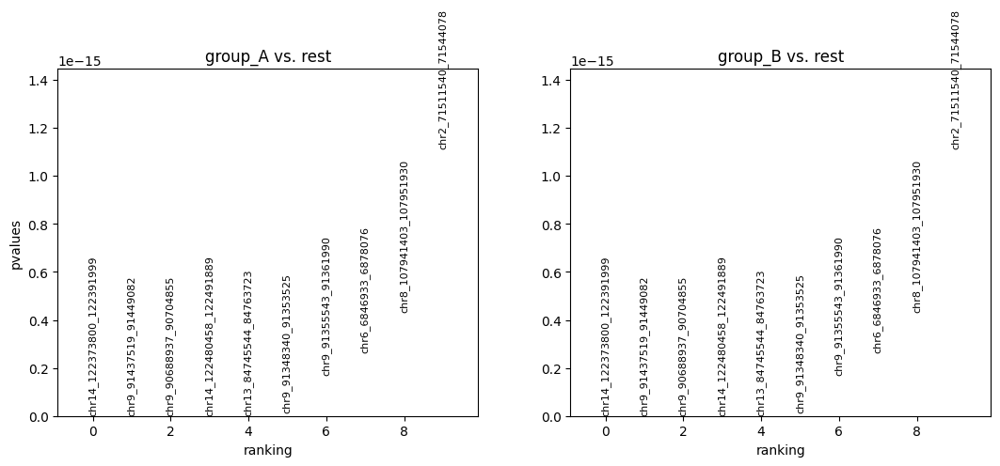

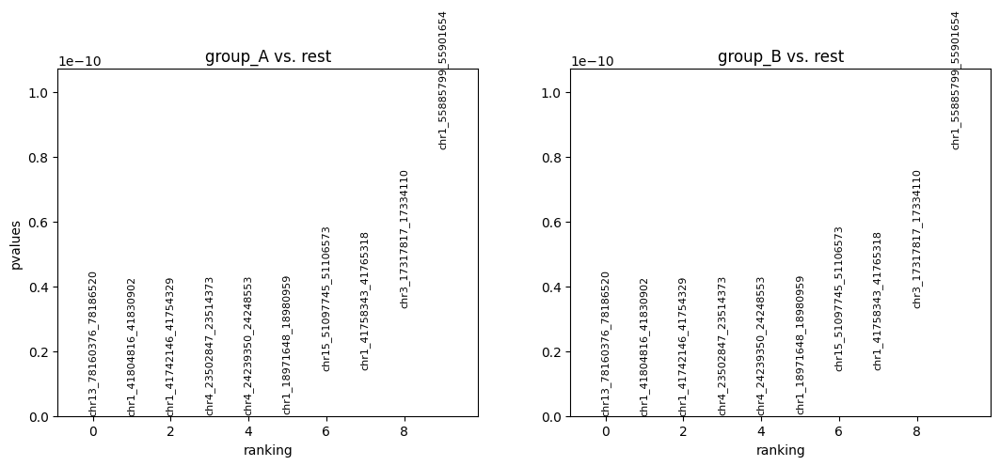

In [62]:
for n in range(36,51):
    cc.pl.rank_peak_groups(globals()[f'adata_cc_shuff{n}'], key = 'fisher_exact', rankby = 'pvalues')

In [36]:
adata_cc_shuff21.var

,Chr,Start,End,Nearest Refseq1,Gene Name1,Direction1,Distance1,Nearest Refseq2,Gene Name2,Direction2,...,Direction3,Distance3,Nearest Refseq4,Gene Name4,Direction4,Distance4,Nearest Refseq5,Gene Name5,Direction5,Distance5
name,,,,,,,,,,,,,,,,,,,,,
chr1_3244948_3247104,chr1,3244948,3247104,NM_001011874,Xkr4,-,0.0,,,,...,,inf,,,,inf,,,,inf
chr1_3296962_3300599,chr1,3296962,3300599,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,...,,inf,,,,inf,,,,inf
chr1_3309788_3311048,chr1,3309788,3311048,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,...,,inf,,,,inf,,,,inf
chr1_3319892_3324705,chr1,3319892,3324705,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,...,,inf,,,,inf,,,,inf
chr1_3365161_3374296,chr1,3365161,3374296,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,...,-,969211.0,,,,inf,,,,inf
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrX_169795473_169802207,chrX,169795473,169802207,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,...,+,77412.0,NM_001331049,Hccs,-,-475102.0,NM_009707,Arhgap6,+,-491034.0
chrX_169809434_169813700,chrX,169809434,169813700,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,...,+,65919.0,NM_001331049,Hccs,-,-489063.0,NM_009707,Arhgap6,+,-504995.0
chrX_169927485_169931168,chrX,169927485,169931168,NM_010797,Mid1,+,0.0,NM_001331049,Hccs,-,...,+,-623046.0,NM_001081978,Amelx,-,-740277.0,NM_001199212,Asmt,+,741476.0


In [63]:
# concatenate fisher results to table
for n in range(36,51):
    dedata = cc.tl.rank_peak_groups_df(globals()[f'adata_cc_shuff{n}'],'fisher_exact')
    dedata = dedata.set_index(['names'])
    globals()[f'adata_cc_shuff{n}'].var = pd.concat([globals()[f'adata_cc_shuff{n}'].var, dedata[(dedata['group'] == 'group_B')]], axis=1)


In [65]:
adata_cc_shuff42.var

,Chr,Start,End,Nearest Refseq1,Gene Name1,Direction1,Distance1,Nearest Refseq2,Gene Name2,Direction2,Distance2,Nearest Refseq3,Gene Name3,Direction3,Distance3,Nearest Refseq4,Gene Name4,Direction4,Distance4,Nearest Refseq5,Gene Name5,Direction5,Distance5,logfoldchanges,pvalues,pvalues_adj,number,number_rest,total,total_rest,group
chr1_3245070_3247104,chr1,3245070,3247104,NM_001011874,Xkr4,-,0.0,,,,inf,,,,inf,,,,inf,,,,inf,0.069608,0.804753,1.000000,76,71,1857244,1823026,group_B
chr1_3296871_3300959,chr1,3296871,3300959,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,989887.0,,,,inf,,,,inf,,,,inf,-0.098948,0.710325,0.985307,56,59,1857244,1823026,group_B
chr1_3309788_3310827,chr1,3309788,3310827,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,980019.0,,,,inf,,,,inf,,,,inf,-0.069915,0.898401,1.000000,30,31,1857244,1823026,group_B
chr1_3319892_3324705,chr1,3319892,3324705,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,966141.0,,,,inf,,,,inf,,,,inf,-0.153573,0.521013,0.939811,74,81,1857244,1823026,group_B
chr1_3365567_3372481,chr1,3365567,3372481,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,918365.0,NM_011283,Rp1,-,971026.0,,,,inf,,,,inf,-0.004225,1.000000,1.000000,129,127,1857244,1823026,group_B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrX_169795473_169802207,chrX,169795473,169802207,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,25952.0,NM_001290506,Mid1,+,77412.0,NM_001331049,Hccs,-,-475102.0,NM_009707,Arhgap6,+,-491034.0,0.233395,0.409461,0.902701,65,54,1857244,1823026,group_B
chrX_169809434_169813700,chrX,169809434,169813700,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,14459.0,NM_001290506,Mid1,+,65919.0,NM_001331049,Hccs,-,-489063.0,NM_009707,Arhgap6,+,-504995.0,-0.025557,1.000000,1.000000,37,37,1857244,1823026,group_B
chrX_169924092_169930498,chrX,169924092,169930498,NM_010797,Mid1,+,0.0,NM_001331049,Hccs,-,-603721.0,NM_009707,Arhgap6,+,-619653.0,NM_001081978,Amelx,-,-736884.0,NM_001199212,Asmt,+,742146.0,0.261592,0.392969,0.896625,48,39,1857244,1823026,group_B
chrX_169979401_169985593,chrX,169979401,169985593,NM_010797,Mid1,+,0.0,NM_001331049,Hccs,-,-659030.0,NM_009707,Arhgap6,+,-674962.0,NM_001199212,Asmt,+,687051.0,NM_001081978,Amelx,-,-792193.0,0.467109,0.129794,0.784805,50,35,1857244,1823026,group_B


In [66]:
for n in range(36,51):
    globals()[f'array_shuff{n}_T'] = globals()[f'array_shuff{n}'].T

In [67]:
array_shuff41_T

,11_1,15_7,16_7,1_5,3_1,5_2,5_5,7_4,8_1,9_5,11_5,14_5,16_6,2_2,3_2,4_2,4_3,5_1,6_5,9_4
name,,,,,,,,,,,,,,,,,,,,
chr1_3219744_3221852,3.0,2.0,6.0,1.0,7.0,1.0,4.0,2.0,7.0,12.0,1.0,7.0,3.0,2.0,0.0,2.0,7.0,0.0,2.0,2.0
chr1_3245070_3247104,5.0,5.0,15.0,3.0,9.0,0.0,6.0,2.0,13.0,14.0,6.0,7.0,10.0,10.0,2.0,15.0,18.0,2.0,5.0,0.0
chr1_3296043_3300599,2.0,6.0,15.0,3.0,6.0,0.0,0.0,2.0,7.0,9.0,3.0,21.0,8.0,3.0,4.0,8.0,15.0,1.0,2.0,1.0
chr1_3309788_3310809,2.0,2.0,11.0,0.0,1.0,2.0,2.0,1.0,2.0,3.0,5.0,6.0,2.0,5.0,3.0,3.0,7.0,0.0,3.0,1.0
chr1_3319892_3324705,10.0,6.0,19.0,5.0,8.0,1.0,2.0,6.0,6.0,11.0,7.0,17.0,6.0,14.0,4.0,9.0,20.0,1.0,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrX_169795473_169802450,6.0,3.0,7.0,3.0,8.0,1.0,3.0,2.0,5.0,16.0,6.0,10.0,5.0,7.0,0.0,11.0,22.0,3.0,3.0,1.0
chrX_169809434_169813700,3.0,1.0,9.0,1.0,3.0,0.0,3.0,1.0,7.0,8.0,5.0,3.0,2.0,6.0,1.0,9.0,12.0,0.0,0.0,0.0
chrX_169924092_169930498,3.0,3.0,4.0,5.0,6.0,1.0,2.0,0.0,6.0,7.0,2.0,7.0,5.0,2.0,3.0,13.0,12.0,1.0,4.0,1.0


In [68]:
# concatenate insertion counts to table
for n in range(36,51):
    globals()[f'adata_cc_shuff{n}'].var = pd.concat([globals()[f'adata_cc_shuff{n}'].var, globals()[f'array_shuff{n}_T'] ], axis = 1)

In [42]:
pd.set_option('display.max_columns', None)
adata_cc_shuff21.var

,Chr,Start,End,Nearest Refseq1,Gene Name1,Direction1,Distance1,Nearest Refseq2,Gene Name2,Direction2,Distance2,Nearest Refseq3,Gene Name3,Direction3,Distance3,Nearest Refseq4,Gene Name4,Direction4,Distance4,Nearest Refseq5,Gene Name5,Direction5,Distance5,logfoldchanges,pvalues,pvalues_adj,number,number_rest,total,total_rest,group,11_1,14_5,16_6,16_7,1_5,4_2,5_1,5_2,5_5,9_5,11_5,15_7,2_2,3_1,3_2,4_3,6_5,7_4,8_1,9_4
chr1_3244948_3247104,chr1,3244948,3247104,NM_001011874,Xkr4,-,0.0,,,,inf,,,,inf,,,,inf,,,,inf,-0.037625,0.934265,1.000000,70,77,1777802,1903996,group_B,5.0,7.0,10.0,15.0,3.0,15.0,2.0,0.0,6.0,14.0,6.0,5.0,10.0,9.0,2.0,18.0,5.0,2.0,13.0,0.0
chr1_3296962_3300599,chr1,3296962,3300599,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,990247.0,,,,inf,,,,inf,,,,inf,-0.298959,0.262474,0.822186,49,65,1777802,1903996,group_B,2.0,21.0,7.0,15.0,3.0,8.0,1.0,0.0,0.0,8.0,3.0,6.0,3.0,6.0,4.0,15.0,2.0,2.0,7.0,1.0
chr1_3309788_3311048,chr1,3309788,3311048,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,979798.0,,,,inf,,,,inf,,,,inf,0.093392,0.800736,0.996481,31,31,1777802,1903996,group_B,2.0,6.0,2.0,11.0,0.0,3.0,0.0,2.0,2.0,3.0,5.0,2.0,5.0,2.0,3.0,7.0,3.0,1.0,2.0,1.0
chr1_3319892_3324705,chr1,3319892,3324705,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,966141.0,,,,inf,,,,inf,,,,inf,-0.030731,0.936001,1.000000,74,81,1777802,1903996,group_B,10.0,17.0,6.0,19.0,5.0,9.0,1.0,1.0,2.0,11.0,7.0,6.0,14.0,8.0,4.0,20.0,2.0,6.0,6.0,1.0
chr1_3365161_3374296,chr1,3365161,3374296,NM_001011874,Xkr4,-,0.0,NM_001195662,Rp1,-,916550.0,NM_011283,Rp1,-,969211.0,,,,inf,,,,inf,-0.007096,1.000000,1.000000,131,141,1777802,1903996,group_B,7.0,15.0,12.0,39.0,4.0,16.0,2.0,3.0,14.0,29.0,20.0,9.0,23.0,20.0,6.0,32.0,3.0,5.0,12.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrX_169795473_169802207,chrX,169795473,169802207,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,25952.0,NM_001290506,Mid1,+,77412.0,NM_001331049,Hccs,-,-475102.0,NM_009707,Arhgap6,+,-491034.0,-0.163466,0.582284,0.938842,54,65,1777802,1903996,group_B,6.0,10.0,5.0,7.0,3.0,11.0,3.0,1.0,3.0,16.0,6.0,3.0,7.0,7.0,0.0,20.0,3.0,2.0,5.0,1.0
chrX_169809434_169813700,chrX,169809434,169813700,NM_010797,Mid1,+,0.0,NM_001290504,Mid1,+,14459.0,NM_001290506,Mid1,+,65919.0,NM_001331049,Hccs,-,-489063.0,NM_009707,Arhgap6,+,-504995.0,0.019941,1.000000,1.000000,36,38,1777802,1903996,group_B,3.0,3.0,2.0,9.0,1.0,9.0,0.0,0.0,3.0,8.0,5.0,1.0,6.0,3.0,1.0,12.0,0.0,1.0,7.0,0.0
chrX_169927485_169931168,chrX,169927485,169931168,NM_010797,Mid1,+,0.0,NM_001331049,Hccs,-,-607114.0,NM_009707,Arhgap6,+,-623046.0,NM_001081978,Amelx,-,-740277.0,NM_001199212,Asmt,+,741476.0,-0.745677,0.051755,0.641399,21,39,1777802,1903996,group_B,2.0,5.0,5.0,2.0,4.0,12.0,1.0,0.0,2.0,6.0,2.0,0.0,4.0,5.0,1.0,7.0,1.0,0.0,1.0,0.0
chrX_169979401_169985046,chrX,169979401,169985046,NM_010797,Mid1,+,0.0,NM_001331049,Hccs,-,-659030.0,NM_009707,Arhgap6,+,-674962.0,NM_001199212,Asmt,+,687598.0,NM_001081978,Amelx,-,-792193.0,-0.138812,0.662154,0.962899,38,45,1777802,1903996,group_B,3.0,8.0,7.0,6.0,5.0,3.0,1.0,0.0,3.0,9.0,6.0,5.0,5.0,3.0,3.0,9.0,1.0,0.0,5.0,1.0


In [69]:
# Write final tables to file
for n in range(36,51):
    globals()[f'adata_cc_shuff{n}'].var.to_csv(f'fisher_shuff{n}.csv')

In [72]:
# How many peaks are significant with these shuffled animals?
# Initialize sig_peak_counts with values from first 20 arrangements
sig_peak_counts = [37, 110, 217, 145, 37, 5, 19, 72, 211, 55, 75, 106, 161, 93, 48, 40, 111, 42, 70, 58]
for n in range(21,51):
    count = sum(globals()[f'adata_cc_shuff{n}'].var['pvalues_adj'] < 0.05)
    print(f'Shuffle {n}: {count} peaks with adj p-value < 0.05')
    sig_peak_counts.append(count)

Shuffle 21: 12 peaks with adj p-value < 0.05
Shuffle 22: 43 peaks with adj p-value < 0.05
Shuffle 23: 181 peaks with adj p-value < 0.05
Shuffle 24: 260 peaks with adj p-value < 0.05
Shuffle 25: 19 peaks with adj p-value < 0.05
Shuffle 26: 29 peaks with adj p-value < 0.05
Shuffle 27: 5 peaks with adj p-value < 0.05
Shuffle 28: 64 peaks with adj p-value < 0.05
Shuffle 29: 62 peaks with adj p-value < 0.05
Shuffle 30: 51 peaks with adj p-value < 0.05
Shuffle 31: 107 peaks with adj p-value < 0.05
Shuffle 32: 9 peaks with adj p-value < 0.05
Shuffle 33: 121 peaks with adj p-value < 0.05
Shuffle 34: 46 peaks with adj p-value < 0.05
Shuffle 35: 52 peaks with adj p-value < 0.05
Shuffle 36: 125 peaks with adj p-value < 0.05
Shuffle 37: 67 peaks with adj p-value < 0.05
Shuffle 38: 15 peaks with adj p-value < 0.05
Shuffle 39: 115 peaks with adj p-value < 0.05
Shuffle 40: 29 peaks with adj p-value < 0.05
Shuffle 41: 103 peaks with adj p-value < 0.05
Shuffle 42: 16 peaks with adj p-value < 0.05
Shuff

In [73]:
sig_peak_counts

[37,
 110,
 217,
 145,
 37,
 5,
 19,
 72,
 211,
 55,
 75,
 106,
 161,
 93,
 48,
 40,
 111,
 42,
 70,
 58,
 12,
 43,
 181,
 260,
 19,
 29,
 5,
 64,
 62,
 51,
 107,
 9,
 121,
 46,
 52,
 125,
 67,
 15,
 115,
 29,
 103,
 16,
 90,
 17,
 4,
 73,
 26,
 19,
 102,
 94]

In [74]:
# Check if the sig peak counts have a normal distribution
stat, p = stats.shapiro(sig_peak_counts)
print('Statistics=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably Gaussian')
else:
    print('Probably not Gaussian')

Statistics=0.893, p=0.000
Probably not Gaussian


In [75]:
def check_if_in_normal_distribution(value, mean, std_dev, threshold=0.05):
    """
    Checks if a value falls within a normal distribution with given mean and standard deviation.

    Parameters:
        value: The value to check.
        mean: The mean of the normal distribution.
        std_dev: The standard deviation of the normal distribution.
        threshold: The significance level for determining if the value is within the distribution.

    Returns:
        True if the value is within the distribution, False otherwise.
    """

    z_score = (value - mean) / std_dev
    p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

    return p_value > threshold

In [76]:
#Check if value is within distribution
is_within_distribution = check_if_in_normal_distribution(243, np.mean(sig_peak_counts), np.std(sig_peak_counts))

print(f"Is 243 within the normal distribution? {is_within_distribution}")

Is 243 within the normal distribution? False


In [77]:
#Calculate z-score
zs = (243-np.mean(sig_peak_counts))/np.std(sig_peak_counts)
print(zs)

2.9173657586299795


In [79]:
print("median "+str(np.median(sig_peak_counts))+", mean "+str(np.mean(sig_peak_counts)))

median 60.0, mean 73.36


In [80]:
# Get total peak numbers
for n in range(21,51):
    print(len(globals()[f'peak_data_shuff{n}']))

16634
16634
16837
16926
16652
16650
16615
16747
16645
16688
16663
16684
16741
16696
16710
16796
16707
16706
16594
16649
16699
16550
16622
16706
16643
16673
16554
16588
16774
16685
